# Annotations using clustering for cells for cervix_s0

In [1]:
slide_id = "cervix_s0"

In [2]:
import pandas as pd
import scanpy as sc
import spatialdata as sd
import decoupler as dc
from collections import Counter
from bioservices.kegg import KEGG

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## 1. Load the data

In [3]:
sdata = sd.read_zarr(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_with_cells/sdata_cells_{slide_id}.zarr")
sdata

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/spatialdata/_core/spatialdata.py:158: UserWarning: The table is annotating 'cell_labels', which is not present in the SpatialData object.
  self.validate_table_in_spatialdata(v)


SpatialData object, with associated Zarr store: /Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_with_cells/sdata_cells_cervix_s0.zarr
├── Images
│     └── 'he': DataTree[cyx] (3, 46545, 38219), (3, 23273, 19110)
├── Points
│     └── 'st': DataFrame with shape: (<Delayed>, 13) (3D points)
├── Shapes
│     ├── 'cell_boundaries': GeoDataFrame shape: (825663, 1) (2D shapes)
│     └── 'nucleus_boundaries': GeoDataFrame shape: (825663, 1) (2D shapes)
└── Tables
      ├── 'table_cells': AnnData (825663, 5101)
      └── 'table_nuclei': AnnData (825663, 8180)
with coordinate systems:
    ▸ '_st_intrinsic', with elements:
        st (Points)
    ▸ 'global', with elements:
        he (Images), st (Points), cell_boundaries (Shapes), nucleus_boundaries (Shapes)

In [4]:
adata_cells_ini = sdata.tables['table_cells'].copy()
adata_cells_ini

AnnData object with n_obs × n_vars = 825663 × 5101
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'region', 'z_level'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatialdata_attrs'
    obsm: 'spatial'

In [5]:
adata_cells_ini.obs

,cell_id,transcript_counts,control_probe_counts,genomic_control_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,nucleus_count,segmentation_method,region,z_level
0,aaaaaaaa-1,170,0,0,0,0,9,179,72.385471,52.607033,1.0,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0
1,aaaaaaab-1,40,0,0,0,0,8,48,22.713595,15.804688,1.0,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0
2,aaaaaaac-1,63,0,1,0,0,8,72,32.422189,17.881876,1.0,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0
3,aaaaaaad-1,180,1,0,0,0,19,200,89.590003,38.292501,1.0,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0
4,aaaaaaae-1,137,0,0,0,0,19,156,41.859845,27.003438,1.0,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
840382,aaamjjdk-1,13,0,0,0,0,7,20,18.875313,16.075626,1.0,Segmented by nucleus expansion of 5.0µm,cell_labels,5.0
840383,aaamjjdl-1,3,0,0,0,0,0,3,5.644531,5.644531,1.0,Segmented by nucleus expansion of 5.0µm,cell_labels,4.0
840384,aaamjjdm-1,13,0,0,0,0,2,15,21.539532,16.662657,1.0,Segmented by nucleus expansion of 5.0µm,cell_labels,5.0
840385,aaamjjdn-1,8,0,0,0,0,2,10,14.585469,9.798907,1.0,Segmented by nucleus expansion of 5.0µm,cell_labels,5.0


In [6]:
adata_cells_ini.var

,gene_ids,feature_types,genome
A2ML1,ENSG00000166535,Gene Expression,Unknown
AAMP,ENSG00000127837,Gene Expression,Unknown
AAR2,ENSG00000131043,Gene Expression,Unknown
AARSD1,ENSG00000266967,Gene Expression,Unknown
ABAT,ENSG00000183044,Gene Expression,Unknown
...,...,...,...
ZSCAN26,ENSG00000197062,Gene Expression,Unknown
ZSWIM6,ENSG00000130449,Gene Expression,Unknown
ZUP1,ENSG00000153975,Gene Expression,Unknown
ZYG11B,ENSG00000162378,Gene Expression,Unknown


In [3]:
adata_nuclei = sc.read_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_refine_tangram/adata_refine_tangram_{slide_id}.h5ad")
adata_nuclei

AnnData object with n_obs × n_vars = 718435 × 8180
    obs: 'region', 'slide', 'cell_id', 'area', 'ct_tangram', 'transcript_counts', 'pca_n20_pcs16_leiden_res0.2', 'pca_n20_pcs16_leiden_res0.4', 'pca_n20_pcs16_leiden_res0.6', 'refine_res', 'label1', 'label2', 'label3'
    var: 'mean', 'std'
    uns: 'ct_tangram_colors', 'label1_colors', 'label2_colors', 'label3_colors', 'leiden', 'log1p', 'pca', 'pca_n20_pcs16', 'pca_n20_pcs16_leiden_res0.2_colors', 'pca_n20_pcs16_leiden_res0.4_colors', 'pca_n20_pcs16_leiden_res0.6_colors', 'rank_genes_pca_n20_pcs16_leiden_res0.4', 'rank_genes_refine_res', 'refine_res_colors', 'sopa_attrs', 'spatialdata_attrs', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial', 'tangram_pred'
    varm: 'PCs'
    layers: 'count', 'log_norm'
    obsp: 'pca_n20_pcs16_connectivities', 'pca_n20_pcs16_distances'

In [8]:
adata_nuclei.obs

,region,slide,cell_id,area,ct_tangram,transcript_counts,pca_n20_pcs16_leiden_res0.2,pca_n20_pcs16_leiden_res0.4,pca_n20_pcs16_leiden_res0.6,refine_res,label1,label2,label3
aaaaaaaa-1,nucleus_boundaries,morpho,aaaaaaaa-1,50.213408,Plasma cell,119,3,7,9,9,Epithelial,Cancerous_cervical_epithelial_cell,cancer_cell
aaaaaaab-1,nucleus_boundaries,morpho,aaaaaaab-1,14.382159,MMP19 macrophage,35,1,8,10,10,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell
aaaaaaac-1,nucleus_boundaries,morpho,aaaaaaac-1,16.571872,CXCL13 exhausted CD8 T,54,1,8,10,10,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,36.304979,Naive CD4 T cell,120,3,7,9,9,Epithelial,Cancerous_cervical_epithelial_cell,cancer_cell
aaaaaaae-1,nucleus_boundaries,morpho,aaaaaaae-1,25.152272,Ovarian cancer specific LGR5 MUC16 epithelial ...,104,3,7,9,9,Epithelial,Cancerous_cervical_epithelial_cell,cancer_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...
aaamjjcj-1,nucleus_boundaries,morpho,aaamjjcj-1,19.055926,mregDC,18,0,2,2,2,Unknown,Unknown,normal_cell
aaamjjdb-1,nucleus_boundaries,morpho,aaamjjdb-1,9.798531,Proliferation EC,17,0,2,2,2,Unknown,Unknown,normal_cell
aaamjjdh-1,nucleus_boundaries,morpho,aaamjjdh-1,20.703898,B cell,15,1,8,10,10,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell
aaamjjdk-1,nucleus_boundaries,morpho,aaamjjdk-1,14.563144,Pericyte,22,1,8,0,0,Unknown,Unknown,normal_cell


In [9]:
adata_nuclei.var

,mean,std
A2ML1,0.099487,0.668269
AAMP,0.065739,0.558258
AAR2,0.016221,0.282741
AARSD1,0.020560,0.317644
ABAT,0.009879,0.217365
...,...,...
ZSCAN26,0.018516,0.304875
ZSWIM6,0.014568,0.264705
ZUP1,0.020922,0.321273
ZYG11B,0.031528,0.392734


## 2. Preprocessing

<Axes: >

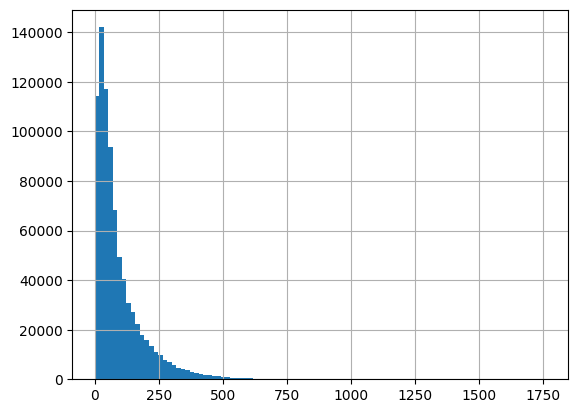

In [10]:
adata_cells_ini.obs['transcript_counts'].hist(bins=100)

<Axes: >

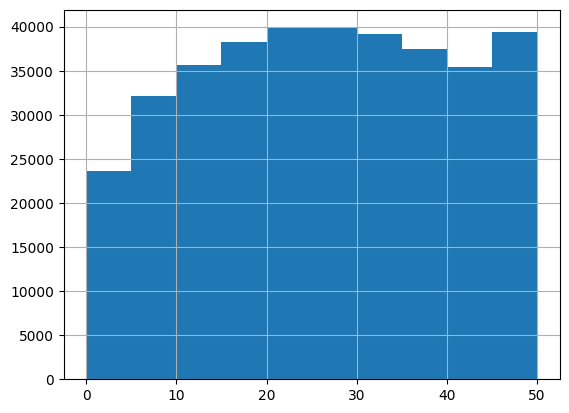

In [11]:
# in range 0-50
adata_cells_ini.obs['transcript_counts'].hist(range=(0,50))

In [12]:
print(f"Number of cells with less than 20 transcripts: {(adata_cells_ini.obs['transcript_counts']<20).sum()}")
print(f"Percentage of cells with less than 20 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<20).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 15 transcripts: {(adata_cells_ini.obs['transcript_counts']<15).sum()}")
print(f"Percentage of cells with less than 15 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<15).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 10 transcripts: {(adata_cells_ini.obs['transcript_counts']<10).sum()}")
print(f"Percentage of cells with less than 10 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<10).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number total of cells: {len(adata_cells_ini.obs)}")

Number of cells with less than 20 transcripts: 129692
Percentage of cells with less than 20 transcripts: 15.71%
-----
Number of cells with less than 15 transcripts: 91404
Percentage of cells with less than 15 transcripts: 11.07%
-----
Number of cells with less than 10 transcripts: 55702
Percentage of cells with less than 10 transcripts: 6.75%
-----
Number total of cells: 825663


In [13]:
adata_cells =  adata_cells_ini[adata_cells_ini.obs['transcript_counts']>10].copy()
print(len(adata_cells.obs))

763077


In [14]:
# Save and do clustering on ruche using gpu
adata_cells.write_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_att/adata_cells_for_gpu_clustering_{slide_id}.h5ad")

In [14]:
# # Save the raw data
# adata_cells.layers['count'] = adata_cells.X.copy()

In [15]:
# # Normalize
# sc.pp.normalize_total(adata_cells, target_sum=1e4)
# sc.pp.log1p(adata_cells)
# adata_cells.layers['log_norm'] = adata_cells.X.copy()

In [16]:
# # Scale each gene to unit variance. Clip values exceeding standard deviation 10.
# sc.pp.scale(adata_cells, max_value=10)

## 3. Principal component analysis

In [ ]:
# # Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.
# sc.tl.pca(adata_cells, svd_solver="arpack", use_highly_variable=False)

In [ ]:
# # Contribution of single PCs to the total variance in the data
# # This gives us information about how many PCs we should consider in order to compute the neighborhood relations of cells, e.g. used in the clustering function  `sc.tl.louvain()` or tSNE `sc.tl.tsne()`
# sc.pl.pca_variance_ratio(adata_cells, log=True)

In [ ]:
# adata_cells

In [20]:
# # Restore X to be log norm counts
# # /!\ ALL the following analysis will use the 'log_norm' layer as input /!\
# dc.swap_layer(adata_cells, 'log_norm', X_layer_key=None, inplace=True)

## 4. The neighborhood graph + clustering

In [ ]:
# # Neighborhood graph of cells using the PCA representation of the data matrix
# sc.pp.neighbors(adata_cells, n_neighbors=20, n_pcs=16, use_rep="X_pca", key_added='pca_n20_pcs16')
# # Embedding the neighborhood graph using UMAP
# sc.tl.umap(adata_cells, neighbors_key='pca_n20_pcs16')
# # Leiden clustering directly clusters the neighborhood graph of cells
# sc.tl.leiden(adata_cells, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n20_pcs16_leiden_res0.2', neighbors_key='pca_n20_pcs16')
# sc.tl.leiden(adata_cells, resolution=0.4, random_state=0, n_iterations=2, directed=False, key_added='pca_n20_pcs16_leiden_res0.4', neighbors_key='pca_n20_pcs16')
# sc.tl.leiden(adata_cells, resolution=0.6, random_state=0, n_iterations=2, directed=False, key_added='pca_n20_pcs16_leiden_res0.6', neighbors_key='pca_n20_pcs16')

In [9]:
# reload adata after clustring on ruche
adata_cells = sc.read_h5ad(f"/Users/felicie-giraud-sauveur/Documents/HE2CellType/code/CT_DS/data/adata_att_clustering/adata_cells_after_gpu_clustering_{slide_id}.h5ad")

In [10]:
adata_cells

AnnData object with n_obs × n_vars = 763077 × 5101
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'region', 'z_level', 'pca_n20_pcs16_leiden_res0.2', 'pca_n20_pcs16_leiden_res0.4', 'pca_n20_pcs16_leiden_res0.6'
    var: 'gene_ids', 'feature_types', 'genome', 'mean', 'std'
    uns: 'leiden', 'log1p', 'pca', 'pca_n20_pcs16', 'spatialdata_attrs', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial'
    varm: 'PCs'
    layers: 'count', 'log_norm'
    obsp: 'pca_n20_pcs16_connectivities', 'pca_n20_pcs16_distances'

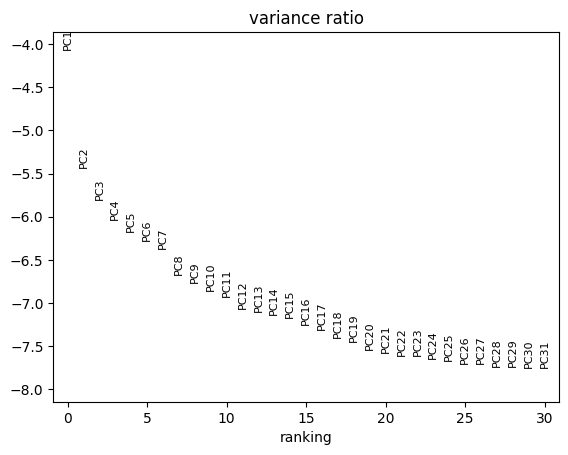

In [11]:
sc.pl.pca_variance_ratio(adata_cells, log=True)

In [12]:
# /!\ ALL the following analysis will use the 'log_norm' layer as input /!\
print(f"Sum count: {adata_cells.layers['count'].sum()}")
print(f"Sum log_norm: {adata_cells.layers['log_norm'].sum()}")
print(f"Sum X: {adata_cells.X.sum()}")

Sum count: 76241928.0
Sum log_norm: 275974624.0
Sum X: 275974624.0


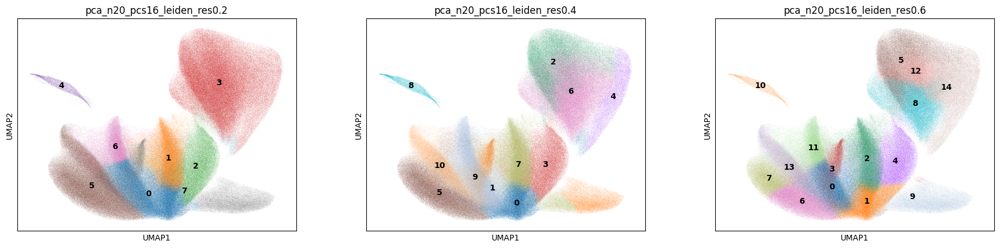

In [14]:
# Plot the clusters
sc.pl.umap(adata_cells, neighbors_key='pca_n20_pcs16',
           color=['pca_n20_pcs16_leiden_res0.2', 'pca_n20_pcs16_leiden_res0.4', 'pca_n20_pcs16_leiden_res0.6'],
           ncols=3, legend_loc='on data')

In [15]:
# Number of clusters
adata_cells.obs['pca_n20_pcs16_leiden_res0.6'].unique()

['10', '9', '4', '2', '5', ..., '11', '0', '3', '6', '7']
Length: 15
Categories (15, object): ['0', '1', '2', '3', ..., '11', '12', '13', '14']

In [16]:
# Refine resolution
adata_cells.obs['refine_res'] = 'att'

adata_cells.obs.loc[adata_cells.obs['pca_n20_pcs16_leiden_res0.6'].isin(['0']), 'refine_res'] = '0'
adata_cells.obs.loc[adata_cells.obs['pca_n20_pcs16_leiden_res0.6'].isin(['1']), 'refine_res'] = '1'
adata_cells.obs.loc[adata_cells.obs['pca_n20_pcs16_leiden_res0.6'].isin(['2']), 'refine_res'] = '2'
adata_cells.obs.loc[adata_cells.obs['pca_n20_pcs16_leiden_res0.6'].isin(['3']), 'refine_res'] = '3'
adata_cells.obs.loc[adata_cells.obs['pca_n20_pcs16_leiden_res0.6'].isin(['4']), 'refine_res'] = '4'
adata_cells.obs.loc[adata_cells.obs['pca_n20_pcs16_leiden_res0.6'].isin(['5']), 'refine_res'] = '5'
adata_cells.obs.loc[adata_cells.obs['pca_n20_pcs16_leiden_res0.6'].isin(['6']), 'refine_res'] = '6'
adata_cells.obs.loc[adata_cells.obs['pca_n20_pcs16_leiden_res0.6'].isin(['7']), 'refine_res'] = '7'
adata_cells.obs.loc[adata_cells.obs['pca_n20_pcs16_leiden_res0.6'].isin(['8']), 'refine_res'] = '8'
adata_cells.obs.loc[adata_cells.obs['pca_n20_pcs16_leiden_res0.6'].isin(['9']), 'refine_res'] = '9'
adata_cells.obs.loc[adata_cells.obs['pca_n20_pcs16_leiden_res0.6'].isin(['10']), 'refine_res'] = '10'
adata_cells.obs.loc[adata_cells.obs['pca_n20_pcs16_leiden_res0.6'].isin(['11']), 'refine_res'] = '11'
adata_cells.obs.loc[adata_cells.obs['pca_n20_pcs16_leiden_res0.6'].isin(['12']), 'refine_res'] = '12'
adata_cells.obs.loc[adata_cells.obs['pca_n20_pcs16_leiden_res0.6'].isin(['13']), 'refine_res'] = '13'
adata_cells.obs.loc[adata_cells.obs['pca_n20_pcs16_leiden_res0.6'].isin(['14']), 'refine_res'] = '14'

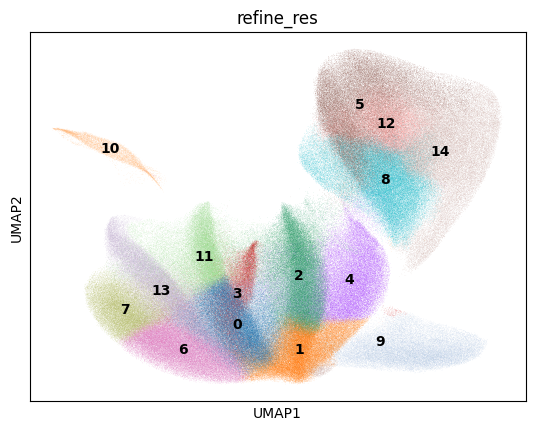

In [17]:
# Plot the clusters
sc.pl.umap(adata_cells, neighbors_key='pca_n20_pcs16', color=['refine_res'], legend_loc='on data')

## 5. Name clusters

**To go from specific gene marker to cell type: http://xteam.xbio.top/CellMarker/search.jsp?cellMarkerSpeciesType=Human&cellMarker=CD5L**

In [18]:
clustering_label = 'refine_res'

In [19]:
merged_df = pd.merge(adata_cells.obs[['cell_id', 'refine_res']].copy(), adata_nuclei.obs[['cell_id', 'label1', 'label2', 'label3']].copy(), on='cell_id', how='outer')

for col in ['label1', 'label2', 'label3']:
    if merged_df[col].dtype.name == 'category':  # Check if already categorical
        merged_df[col] = merged_df[col].cat.add_categories('NA')  # Add 'NA' as a category
merged_df[['label1', 'label2', 'label3']] = merged_df[['label1', 'label2', 'label3']].fillna('NA')

merged_df['label_combined'] = merged_df[['label1', 'label2', 'label3']].apply(lambda x: '&'.join(x.astype(str)), axis=1)

def compare_with_nuclei(merged_df, cluster_id):

    df_filtered = merged_df[merged_df['refine_res'] == cluster_id]
    label_counts = df_filtered['label_combined'].value_counts(normalize=True)
    top_5 = label_counts.head(5)

    top_5_df = top_5.reset_index()
    top_5_df.columns = ['label_combined', 'percentage']
    
    labels_split = top_5_df['label_combined'].str.split('&', expand=True)
    labels_split.columns = ['label1', 'label2', 'label3']

    top_5_df['percentage'] = (top_5_df['percentage'] * 100).round(1).astype(str)

    top_5_df_final = pd.concat([labels_split, top_5_df['percentage']], axis=1)
    
    return top_5_df_final

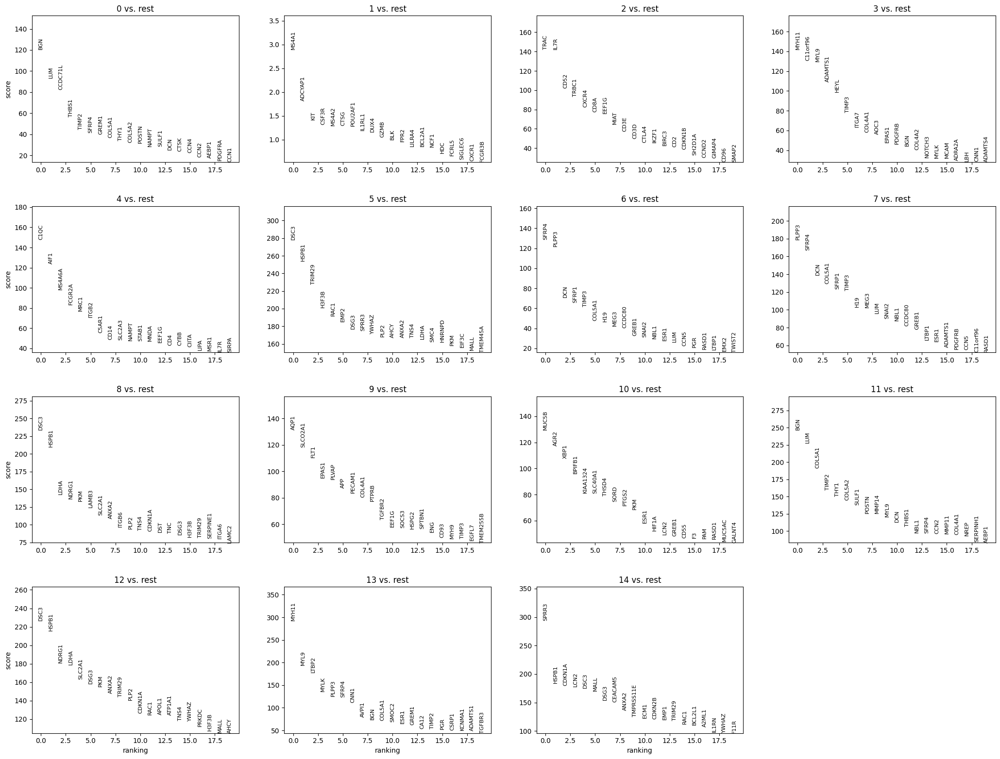

In [20]:
# Wilcoxon rank-sum (Mann-Whitney-U) test. 
# You might also consider much more powerful differential testing packages like MAST, limma, DESeq2 and, for python, the recent diffxpy.
sc.tl.rank_genes_groups(adata_cells, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)
sc.pl.rank_genes_groups(adata_cells, n_genes=20, sharey=False, key="rank_genes_"+clustering_label)

In [21]:
# The top ranked genes per cluster
top_ranked_genes = pd.DataFrame(adata_cells.uns["rank_genes_"+clustering_label]["names"]).iloc[:7, :]
list_genes = pd.concat([top_ranked_genes[col] for col in top_ranked_genes], ignore_index=True).tolist()

In [22]:
adata_cells.obs['label1'] = 'att'
adata_cells.obs['label2'] = 'att'
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

### 5.1. Cluster 0

In [23]:
cluster_id = '0'

In [24]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Fibroblast,CAF,normal_cell,40.0
1,Unknown,Unknown,normal_cell,21.9
2,NA,NA,NA,18.3
3,Smooth_muscle,Smooth_muscle,normal_cell,9.7
4,T,T,normal_cell,4.8


In [25]:
top_ranked_genes[cluster_id]

0        BGN
1        LUM
2    CCDC71L
3      THBS1
4      TIMP2
5      SFRP4
6      GREM1
Name: 0, dtype: object

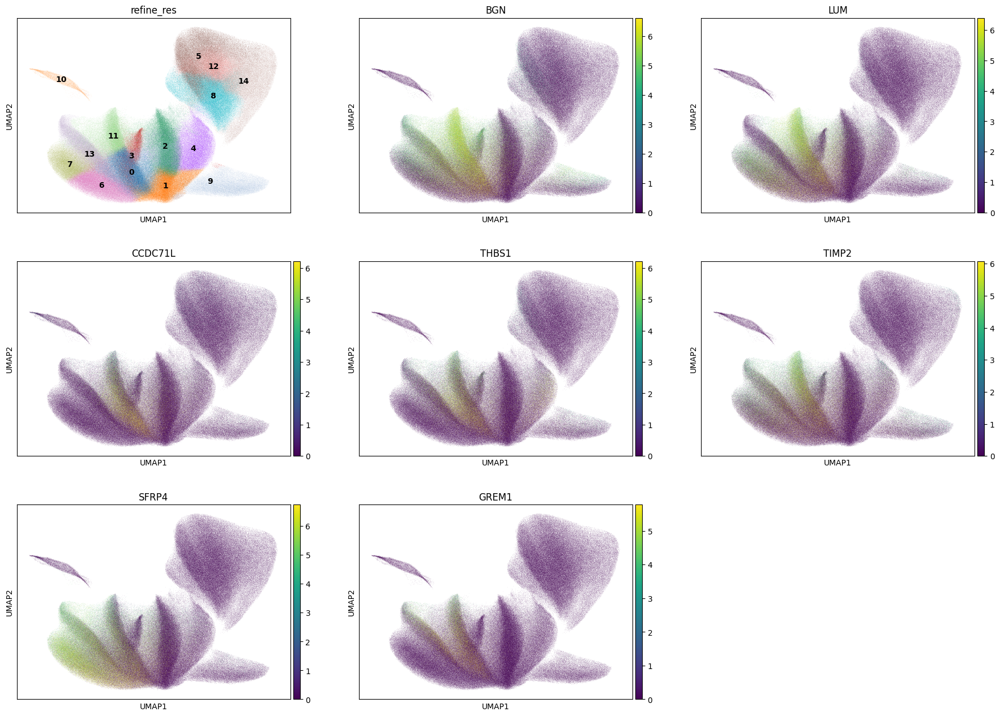

In [26]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [27]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 0: 71837
Percentage of cells in cluster 0: 9.4


In [28]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Fibroblast'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Fibroblast'

### 5.2. Cluster 1

In [29]:
cluster_id = '1'

In [30]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Unknown,Unknown,normal_cell,42.6
1,NA,NA,NA,23.0
2,T,T,normal_cell,19.1
3,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,4.8
4,Fibroblast,CAF,normal_cell,3.8


In [31]:
top_ranked_genes[cluster_id]

0      MS4A1
1    ADCYAP1
2        KIT
3      CSF3R
4      MS4A2
5       CTSG
6    POU2AF1
Name: 1, dtype: object

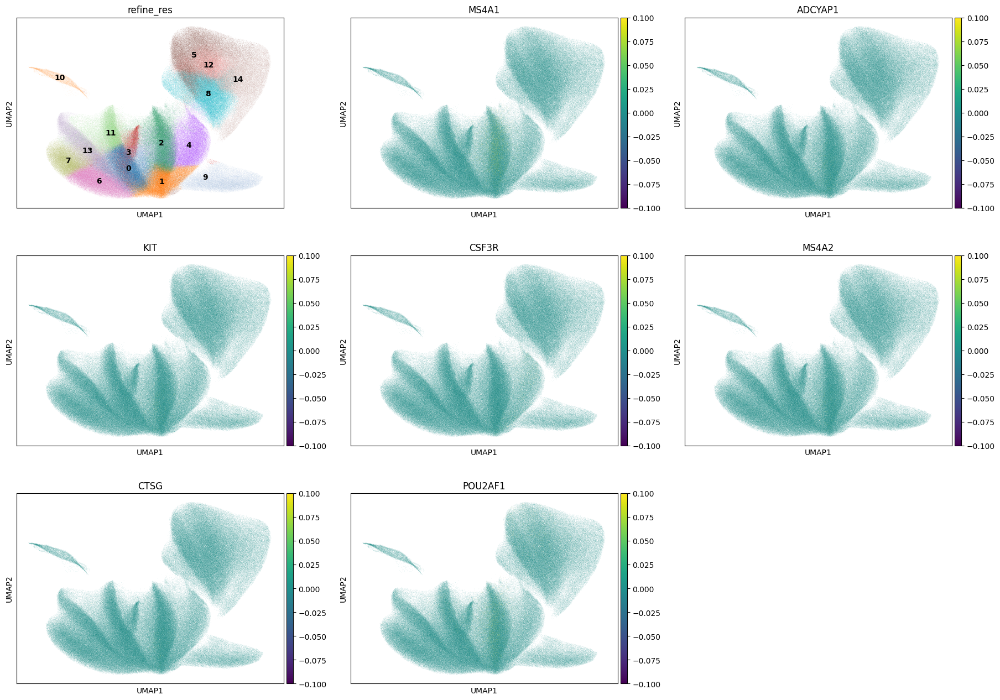

In [32]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [33]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 1: 64603
Percentage of cells in cluster 1: 8.5


In [34]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Unknown'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Unknown'

### 5.3. Cluster 2

In [35]:
cluster_id = '2'

In [36]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,T,T,normal_cell,85.1
1,NA,NA,NA,4.5
2,Unknown,Unknown,normal_cell,4.2
3,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,3.8
4,Fibroblast,CAF,normal_cell,0.8


In [37]:
top_ranked_genes[cluster_id]

0     TRAC
1     IL7R
2     CD52
3    TRBC1
4    CXCR4
5     CD8A
6    EEF1G
Name: 2, dtype: object

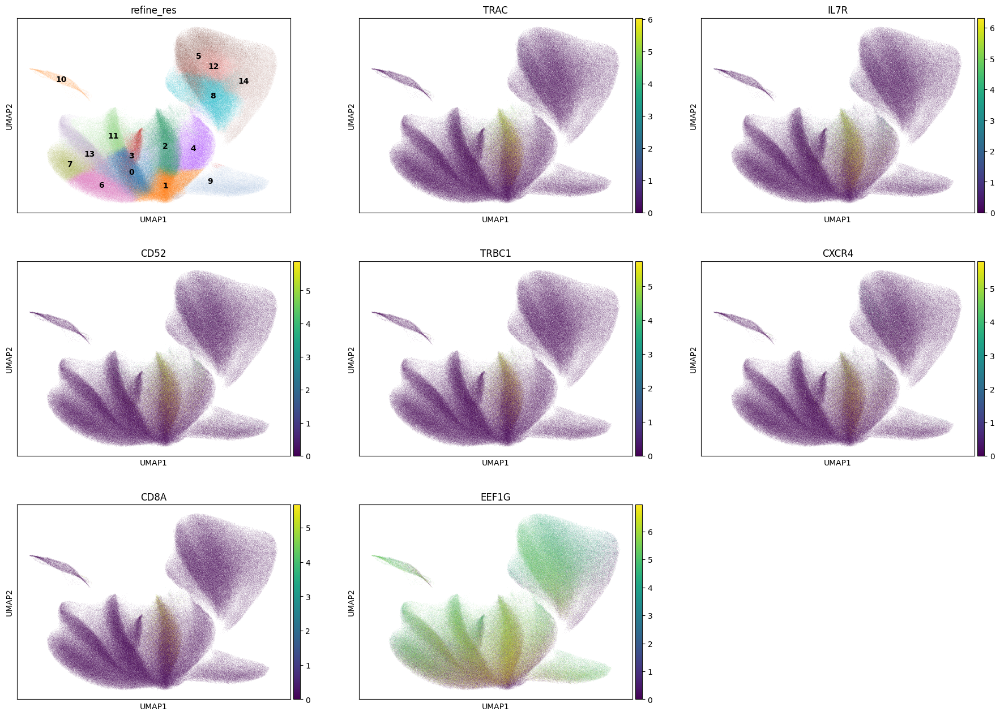

In [38]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [39]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 2: 75312
Percentage of cells in cluster 2: 9.9


In [40]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'T'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'T'

### 5.4. Cluster 3

In [41]:
cluster_id = '3'

In [42]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Smooth_muscle,Smooth_muscle,normal_cell,74.2
1,Unknown,Unknown,normal_cell,8.0
2,NA,NA,NA,7.6
3,Fibroblast,Fibroblast,normal_cell,5.2
4,Fibroblast,CAF,normal_cell,3.0


In [43]:
top_ranked_genes[cluster_id]

0       MYH11
1    C11orf96
2        MYL9
3     ADAMTS1
4        HEYL
5       TIMP3
6       ITGA7
Name: 3, dtype: object

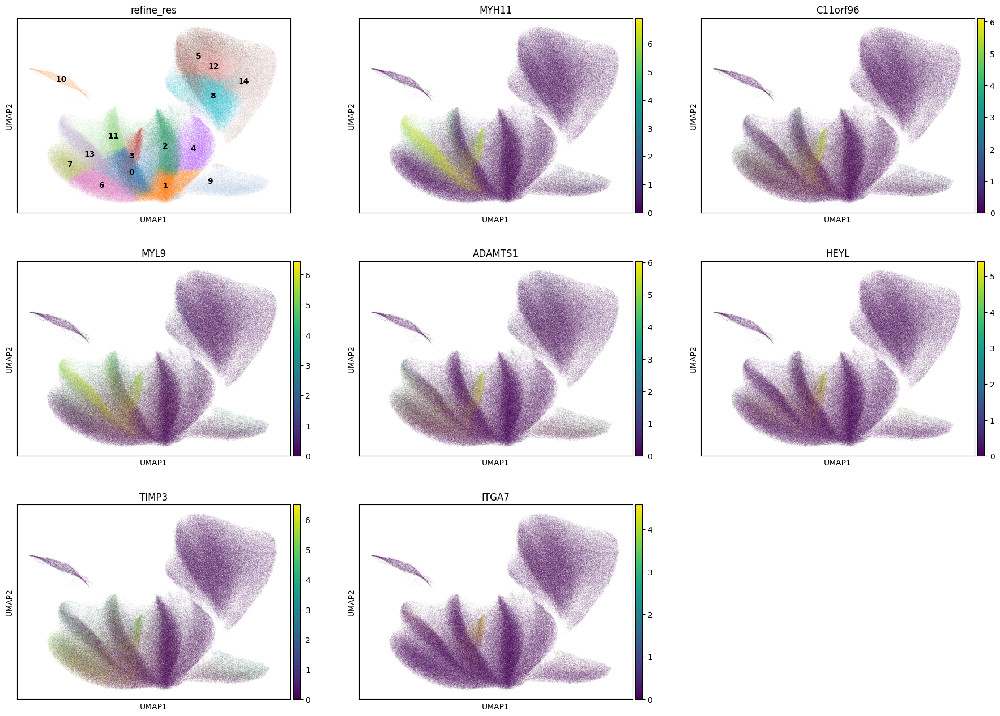

In [44]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [45]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 3: 26426
Percentage of cells in cluster 3: 3.5


In [46]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Smooth_muscle'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Smooth_muscle'

### 5.5. Cluster 4

In [47]:
cluster_id = '4'

In [48]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,65.6
1,Unknown,Unknown,normal_cell,13.0
2,T,T,normal_cell,8.8
3,NA,NA,NA,5.7
4,Fibroblast,CAF,normal_cell,3.0


In [49]:
top_ranked_genes[cluster_id]

0      C1QC
1      AIF1
2    MS4A6A
3    FCGR2A
4      MRC1
5     ITGB2
6     C5AR1
Name: 4, dtype: object

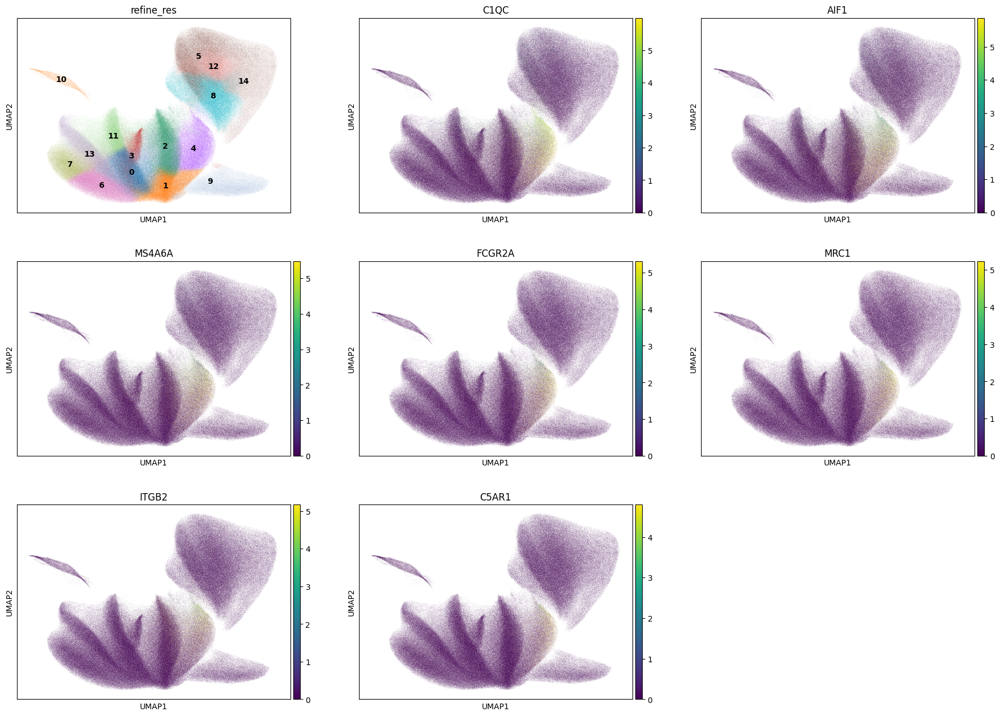

In [50]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [51]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 4: 49129
Percentage of cells in cluster 4: 6.4


In [52]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Monocyte/Macrophage'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Monocyte/Macrophage'

### 5.6. Cluster 5

In [53]:
cluster_id = '5'

In [54]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Cancerous_cervical_epithelial_cell,cancer_cell,97.4
1,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,1.4
2,T,T,normal_cell,0.7
3,Unknown,Unknown,normal_cell,0.3
4,Fibroblast,CAF,normal_cell,0.2


In [55]:
top_ranked_genes[cluster_id]

0      DSC3
1     HSPB1
2    TRIM29
3     H3F3B
4      RAC1
5      EMP2
6      DSG3
Name: 5, dtype: object

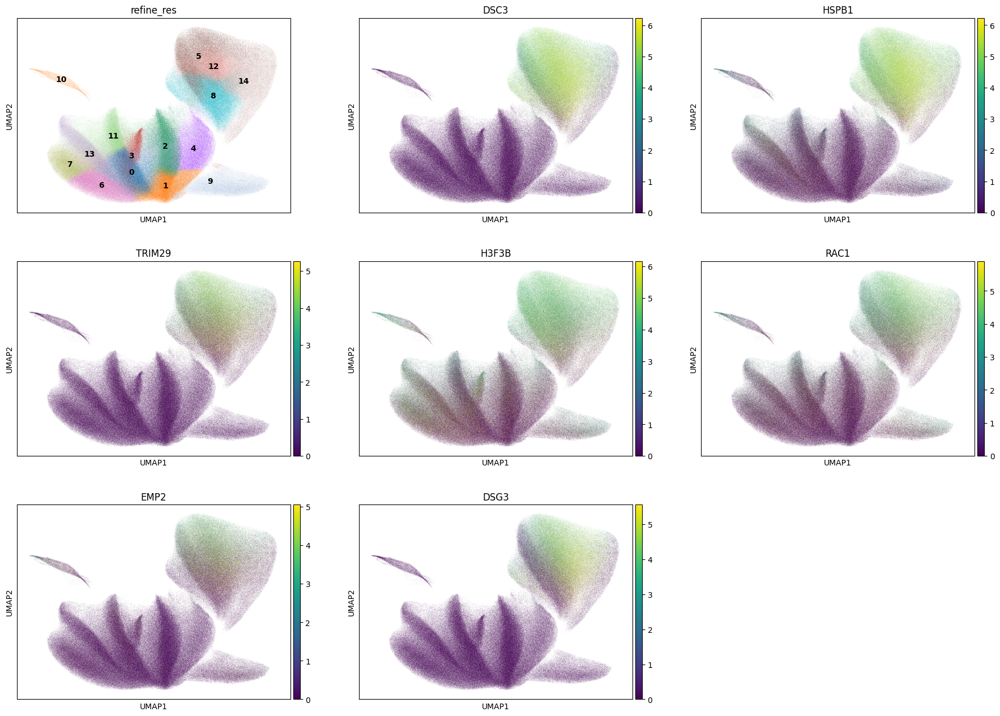

In [56]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [57]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 5: 68194
Percentage of cells in cluster 5: 8.9


In [58]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Squamous_epithelial_cell'

### 5.7. Cluster 6

In [59]:
cluster_id = '6'

In [60]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Unknown,Unknown,normal_cell,41.7
1,Fibroblast,Fibroblast,normal_cell,26.0
2,NA,NA,NA,17.4
3,Smooth_muscle,Smooth_muscle,normal_cell,10.8
4,Fibroblast,CAF,normal_cell,2.5


In [61]:
top_ranked_genes[cluster_id]

0     SFRP4
1     PLPP3
2       DCN
3     SFRP1
4     TIMP3
5    COL5A1
6       H19
Name: 6, dtype: object

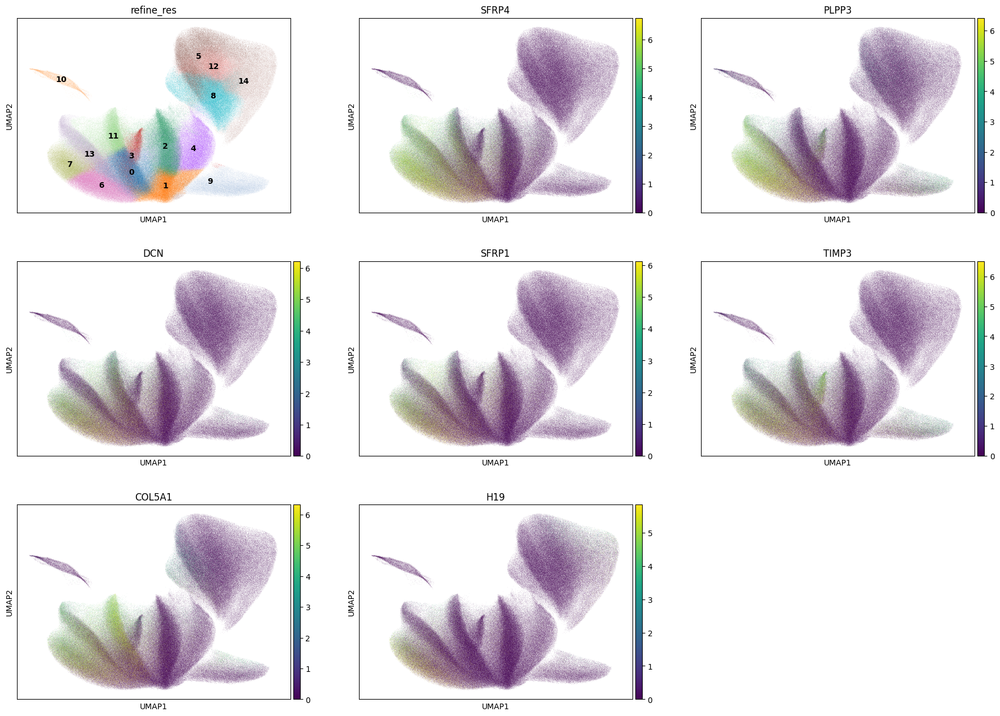

In [62]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [63]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 6: 58464
Percentage of cells in cluster 6: 7.7


In [64]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Fibroblast'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Fibroblast'

### 5.8. Cluster 7

In [65]:
cluster_id = '7'

In [66]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Fibroblast,Fibroblast,normal_cell,80.2
1,Unknown,Unknown,normal_cell,14.0
2,Smooth_muscle,Smooth_muscle,normal_cell,2.9
3,NA,NA,NA,1.2
4,Fibroblast,CAF,normal_cell,0.9


In [67]:
top_ranked_genes[cluster_id]

0     PLPP3
1     SFRP4
2       DCN
3    COL5A1
4     SFRP1
5     TIMP3
6       H19
Name: 7, dtype: object

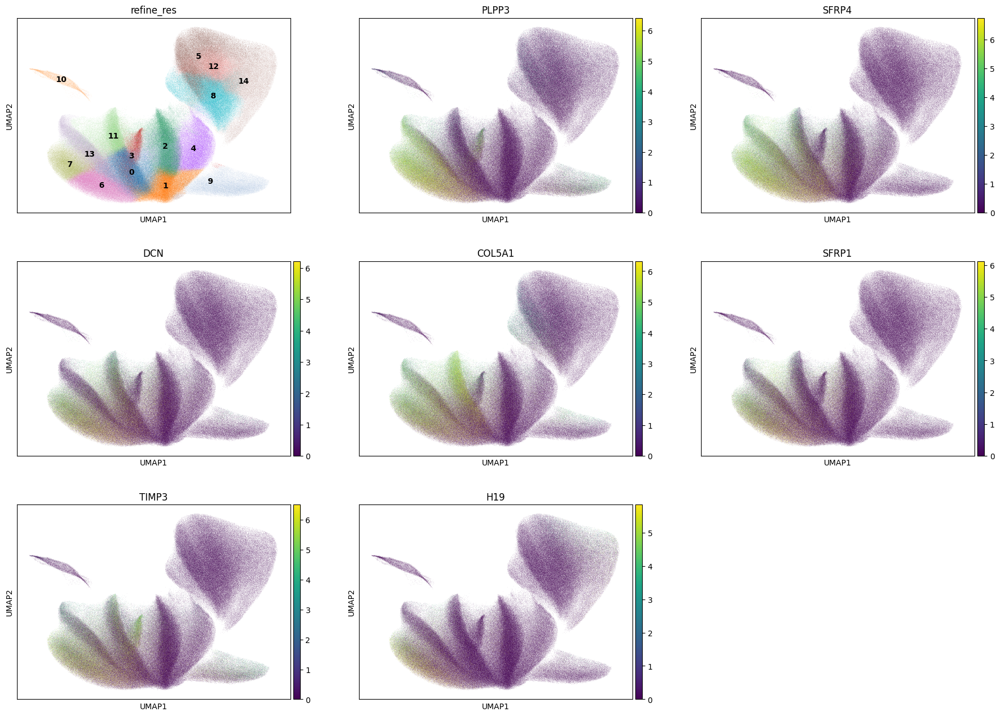

In [68]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [69]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 7: 36588
Percentage of cells in cluster 7: 4.8


In [70]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Fibroblast'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Fibroblast'

### 5.9. Cluster 8

In [71]:
cluster_id = '8'

In [72]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Cancerous_cervical_epithelial_cell,cancer_cell,89.6
1,Unknown,Unknown,normal_cell,5.6
2,NA,NA,NA,2.5
3,T,T,normal_cell,0.8
4,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,0.8


In [73]:
top_ranked_genes[cluster_id]

0      DSC3
1     HSPB1
2      LDHA
3     NDRG1
4       PKM
5     LAMB3
6    SLC2A1
Name: 8, dtype: object

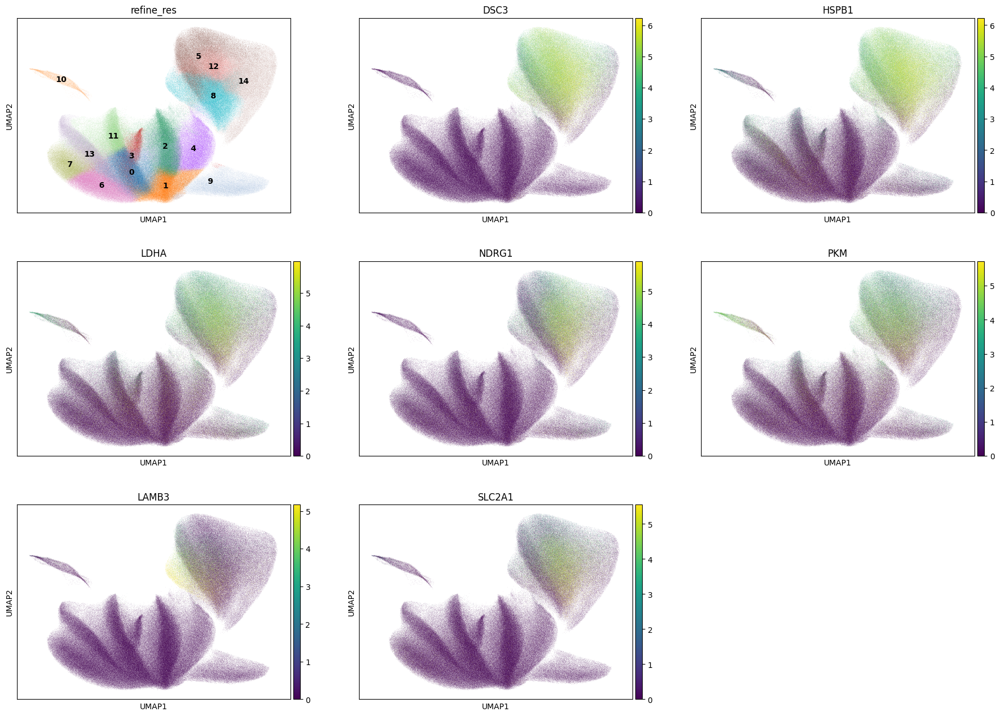

In [74]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [75]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 8: 68542
Percentage of cells in cluster 8: 9.0


In [76]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Squamous_epithelial_cell'

### 5.10. Cluster 9

In [77]:
cluster_id = '9'

In [78]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Endothelial,Endothelial,normal_cell,58.3
1,T,T,normal_cell,13.0
2,Unknown,Unknown,normal_cell,7.2
3,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,6.4
4,Smooth_muscle,Smooth_muscle,normal_cell,5.2


In [79]:
top_ranked_genes[cluster_id]

0       AQP1
1    SLCO2A1
2       FLT1
3      EPAS1
4      PLVAP
5        APP
6     PECAM1
Name: 9, dtype: object

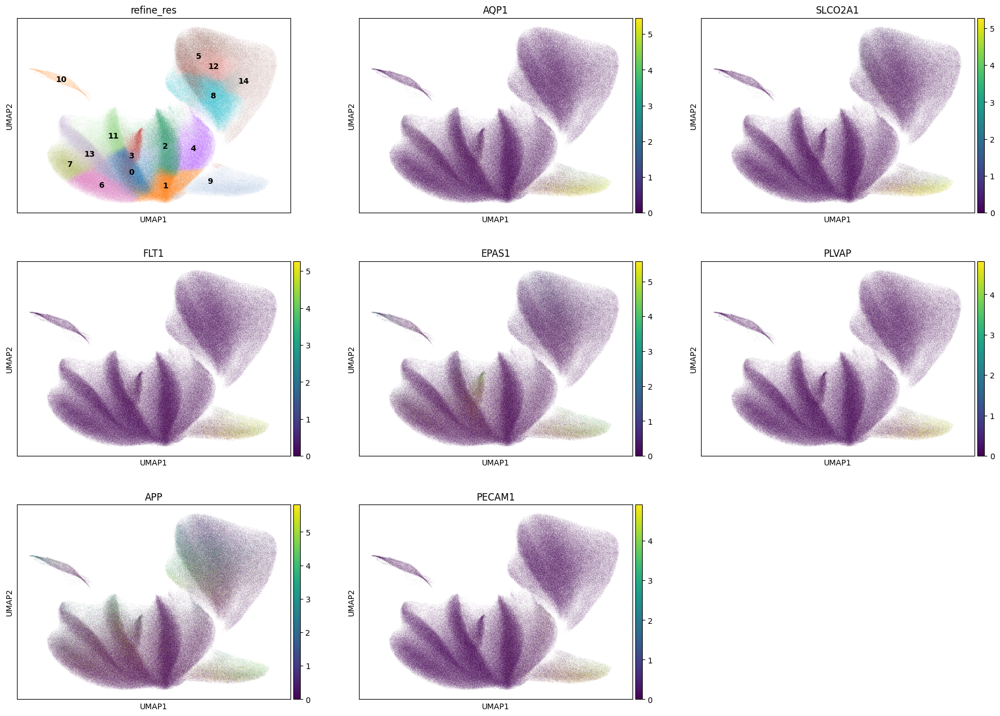

In [80]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [81]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 9: 48982
Percentage of cells in cluster 9: 6.4


In [82]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Endothelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Endothelial'

### 5.11. Cluster 10

In [83]:
cluster_id = '10'

In [84]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Cancerous_cervical_epithelial_cell,cancer_cell,91.2
1,Unknown,Unknown,normal_cell,2.6
2,T,T,normal_cell,2.2
3,NA,NA,NA,1.8
4,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,1.0


In [85]:
top_ranked_genes[cluster_id]

0       MUC5B
1        AGR2
2        XBP1
3      BPIFB1
4    KIAA1324
5     SLC40A1
6       THSD4
Name: 10, dtype: object

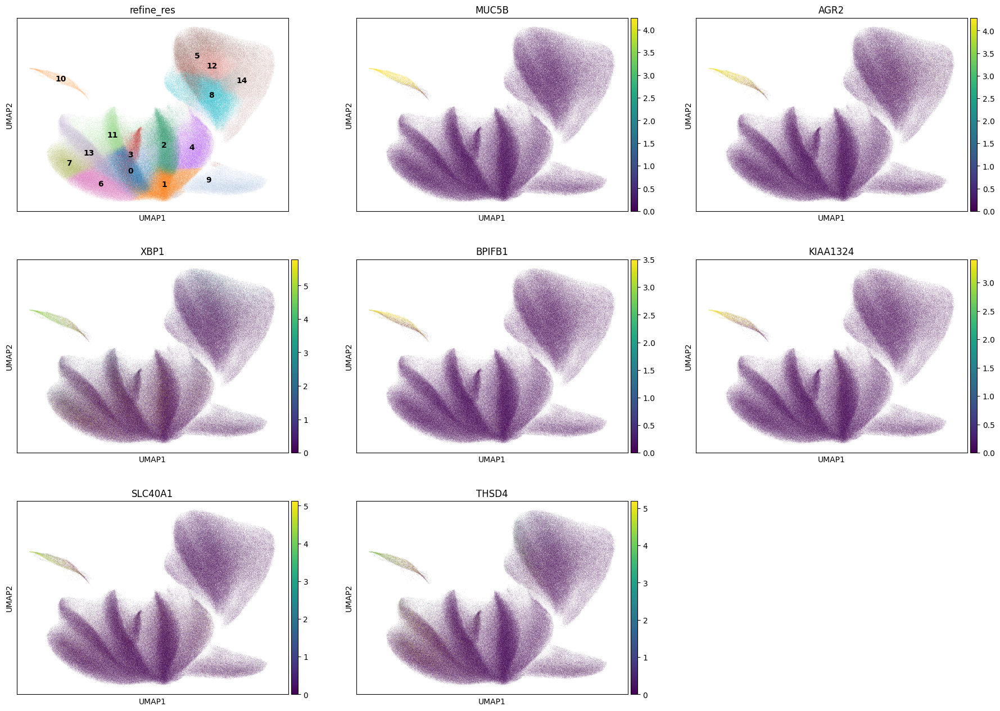

In [86]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [87]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 10: 9576
Percentage of cells in cluster 10: 1.3


In [88]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Secretory_epithelial_cell'

### 5.12. Cluster 11

In [89]:
cluster_id = '11'

In [90]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Fibroblast,CAF,normal_cell,57.6
1,Fibroblast,Fibroblast,normal_cell,18.0
2,Unknown,Unknown,normal_cell,8.1
3,Smooth_muscle,Smooth_muscle,normal_cell,6.6
4,T,T,normal_cell,3.7


In [91]:
top_ranked_genes[cluster_id]

0       BGN
1       LUM
2    COL5A1
3     TIMP2
4      THY1
5    COL5A2
6     SULF1
Name: 11, dtype: object

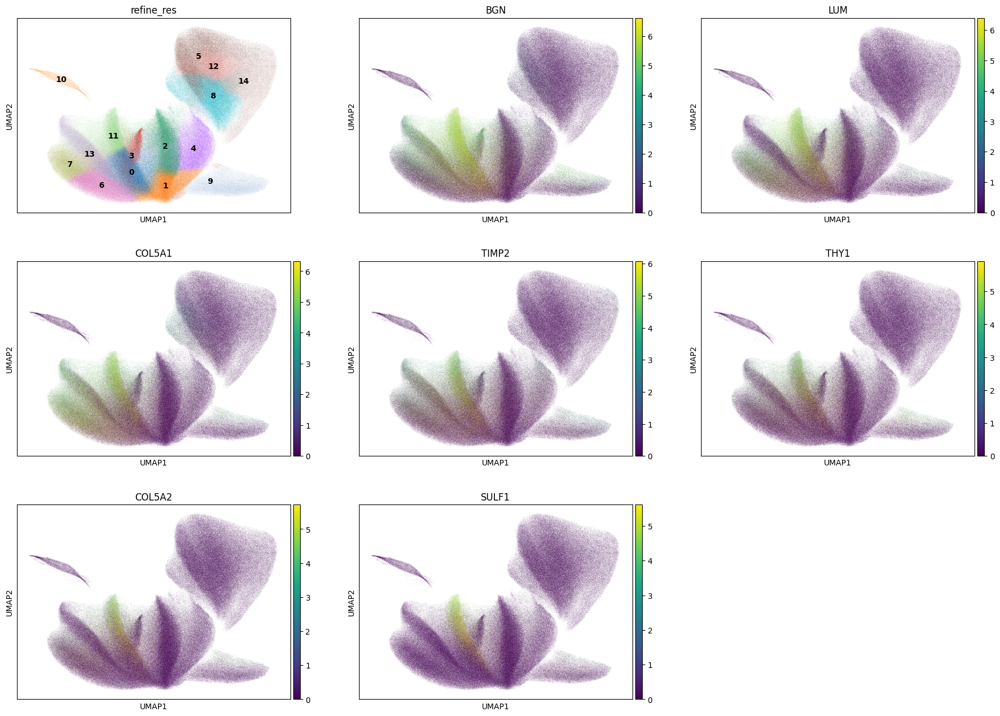

In [92]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [93]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 11: 49097
Percentage of cells in cluster 11: 6.4


In [94]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Fibroblast'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Fibroblast'

### 5.13. Cluster 12

In [95]:
cluster_id = '12'

In [96]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Cancerous_cervical_epithelial_cell,cancer_cell,99.4
1,Unknown,Unknown,normal_cell,0.3
2,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,0.2
3,NA,NA,NA,0.1
4,T,T,normal_cell,0.0


In [97]:
top_ranked_genes[cluster_id]

0      DSC3
1     HSPB1
2     NDRG1
3      LDHA
4    SLC2A1
5      DSG3
6       PKM
Name: 12, dtype: object

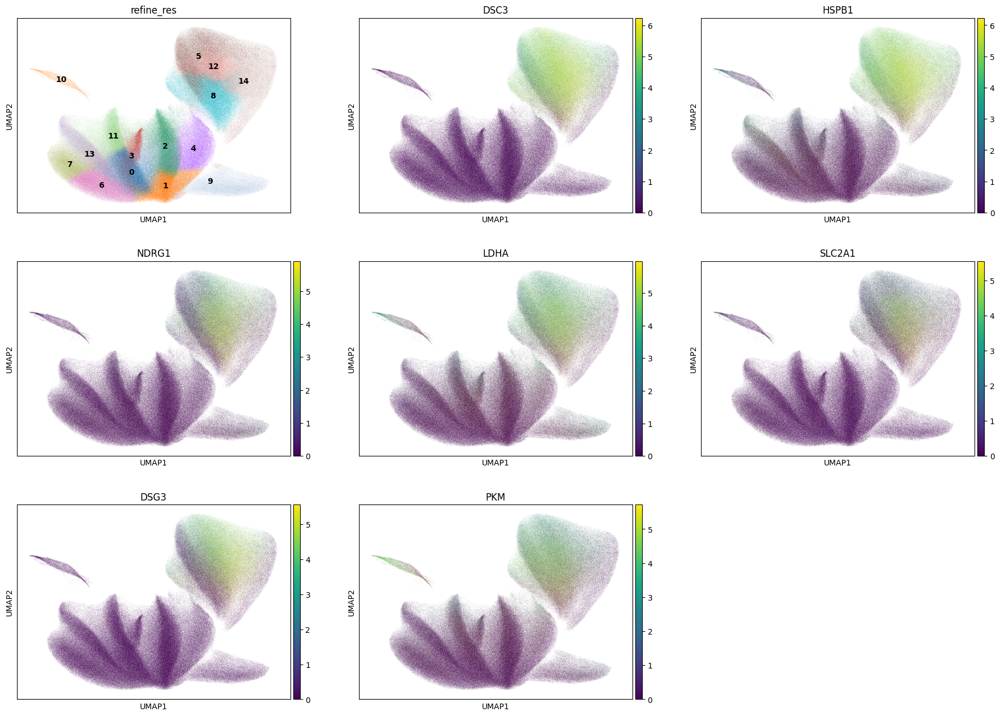

In [98]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [99]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 12: 30224
Percentage of cells in cluster 12: 4.0


In [100]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Squamous_epithelial_cell'

### 5.14. Cluster 13

In [101]:
cluster_id = '13'

In [102]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Smooth_muscle,Smooth_muscle,normal_cell,73.6
1,Unknown,Unknown,normal_cell,9.6
2,NA,NA,NA,7.5
3,Fibroblast,Fibroblast,normal_cell,6.5
4,Fibroblast,CAF,normal_cell,2.1


In [103]:
top_ranked_genes[cluster_id]

0    MYH11
1     MYL9
2    LTBP2
3     MYLK
4    PLPP3
5    SFRP4
6     CNN1
Name: 13, dtype: object

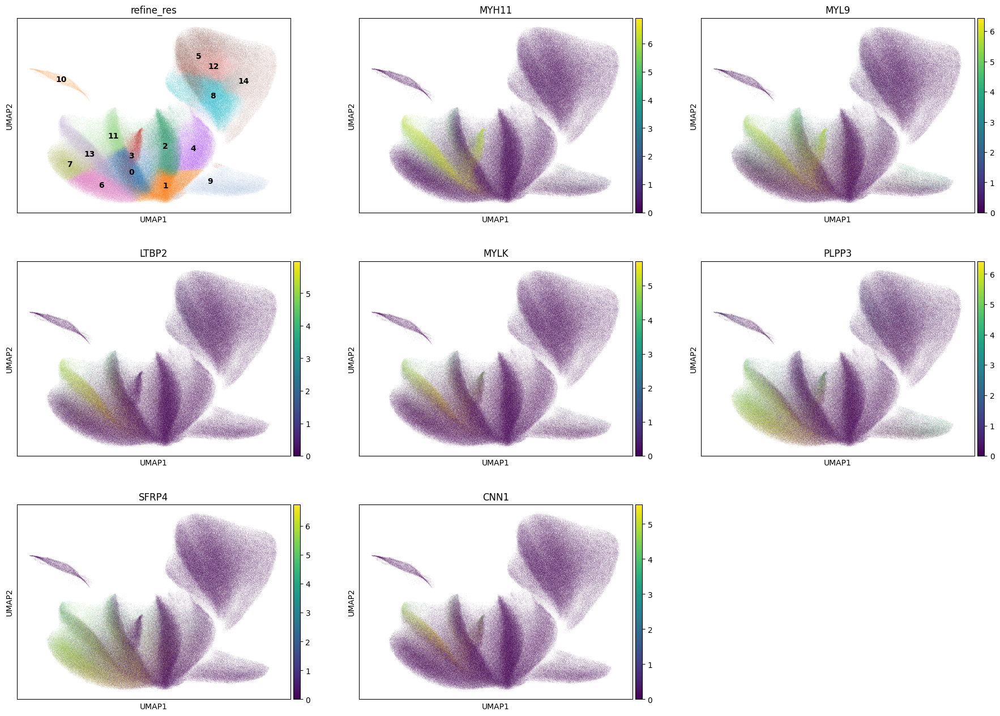

In [104]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [105]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 13: 52989
Percentage of cells in cluster 13: 6.9


In [106]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Smooth_muscle'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Smooth_muscle'

### 5.15. Cluster 14

In [107]:
cluster_id = '14'

In [108]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Cancerous_cervical_epithelial_cell,cancer_cell,86.7
1,Unknown,Unknown,normal_cell,6.6
2,NA,NA,NA,5.2
3,T,T,normal_cell,0.5
4,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,0.5


In [109]:
top_ranked_genes[cluster_id]

0     SPRR3
1     HSPB1
2    CDKN1A
3      LCN2
4      DSC3
5      MALL
6      DSG3
Name: 14, dtype: object

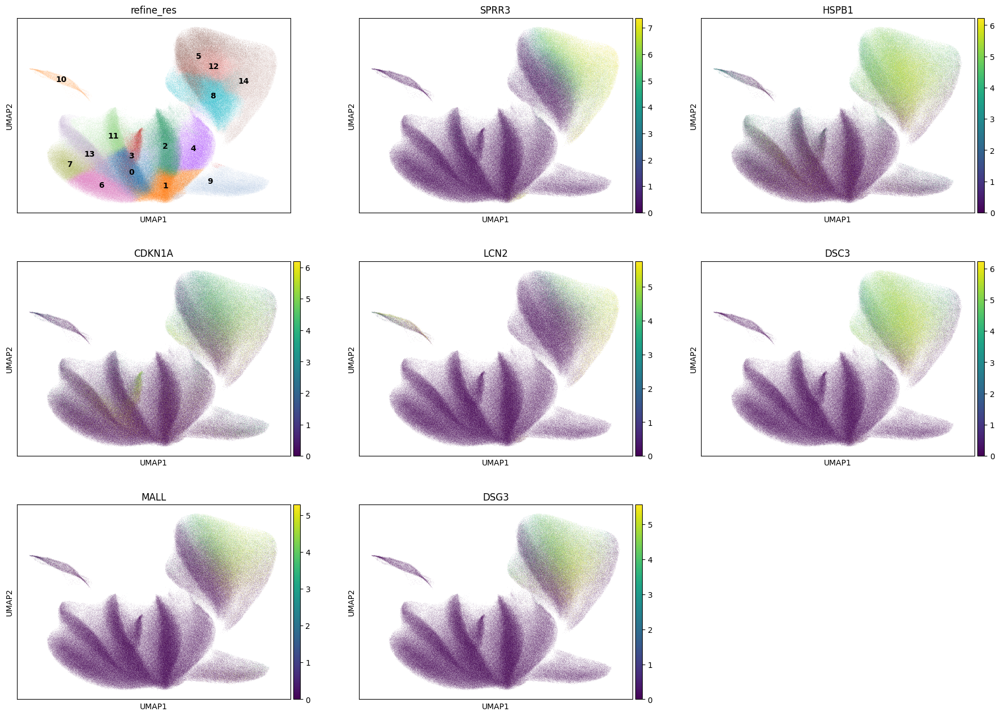

In [110]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [111]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 14: 53114
Percentage of cells in cluster 14: 7.0


In [112]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Squamous_epithelial_cell'

## 6. Cancer cells

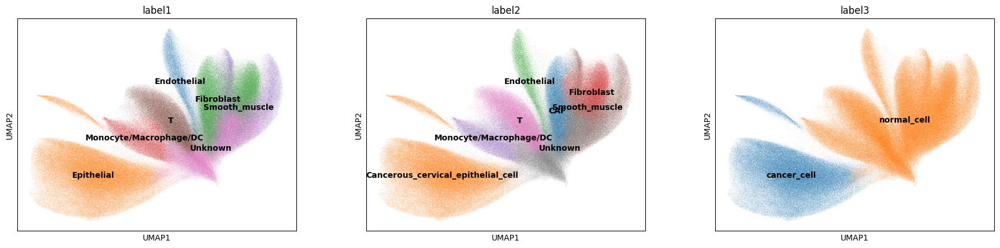

In [113]:
sc.pl.umap(adata_nuclei, color=['label1', 'label2', 'label3'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

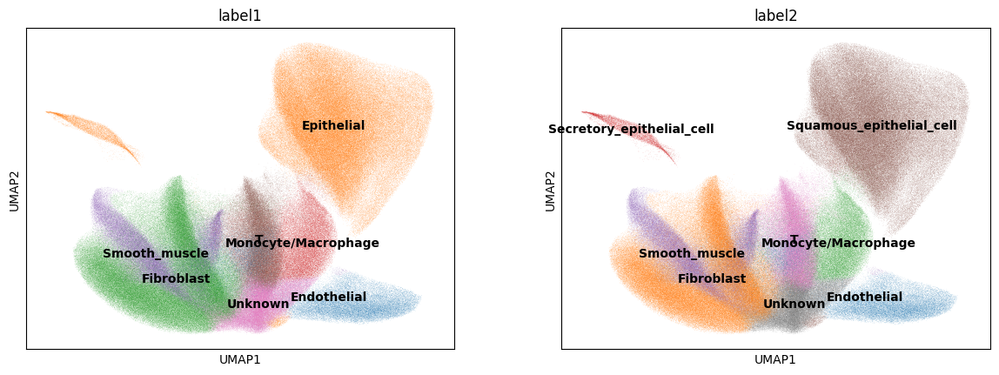

In [114]:
sc.pl.umap(adata_cells, color=['label1', 'label2'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

In [115]:
# Cancer cells
adata_cells.obs['label3'] = 'normal_cell'
adata_cells.obs.loc[adata_cells.obs['label2'].isin(['Squamous_epithelial_cell']), 'label3'] = 'cancer_cell'

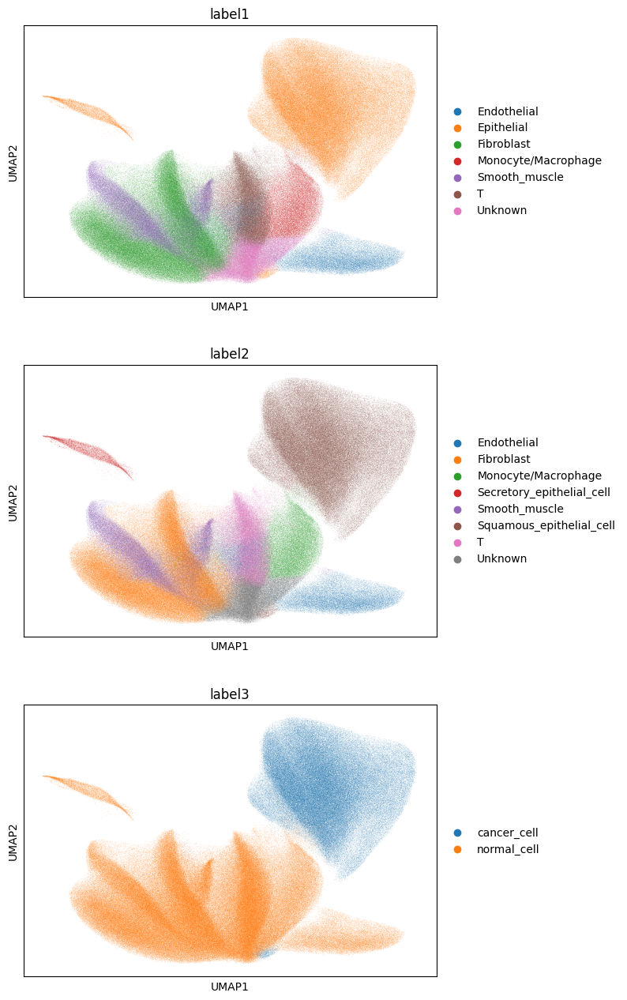

In [116]:
sc.pl.umap(adata_cells, color=['label1', 'label2', 'label3'], ncols=1)

## 7. Save

In [117]:
adata_cells.obs

,cell_id,transcript_counts,control_probe_counts,genomic_control_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,...,segmentation_method,region,z_level,pca_n20_pcs16_leiden_res0.2,pca_n20_pcs16_leiden_res0.4,pca_n20_pcs16_leiden_res0.6,refine_res,label1,label2,label3
0,aaaaaaaa-1,170,0,0,0,0,9,179,72.385471,52.607033,...,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0,4,8,10,10,Epithelial,Secretory_epithelial_cell,normal_cell
1,aaaaaaab-1,40,0,0,0,0,8,48,22.713595,15.804688,...,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0,0,7,9,9,Endothelial,Endothelial,normal_cell
2,aaaaaaac-1,63,0,1,0,0,8,72,32.422189,17.881876,...,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0,4,8,10,10,Epithelial,Secretory_epithelial_cell,normal_cell
3,aaaaaaad-1,180,1,0,0,0,19,200,89.590003,38.292501,...,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0,4,8,10,10,Epithelial,Secretory_epithelial_cell,normal_cell
4,aaaaaaae-1,137,0,0,0,0,19,156,41.859845,27.003438,...,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0,4,8,10,10,Epithelial,Secretory_epithelial_cell,normal_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
840373,aaamjjdb-1,22,0,0,0,0,0,22,35.718595,11.424532,...,Segmented by nucleus expansion of 5.0µm,cell_labels,5.0,5,5,6,6,Fibroblast,Fibroblast,normal_cell
840376,aaamjjde-1,22,0,0,0,0,1,23,50.891096,23.977970,...,Segmented by nucleus expansion of 5.0µm,cell_labels,5.0,4,8,1,1,Unknown,Unknown,normal_cell
840379,aaamjjdh-1,14,0,0,0,0,2,16,35.131564,22.307188,...,Segmented by nucleus expansion of 5.0µm,cell_labels,5.0,2,0,1,1,Unknown,Unknown,normal_cell
840382,aaamjjdk-1,13,0,0,0,0,7,20,18.875313,16.075626,...,Segmented by nucleus expansion of 5.0µm,cell_labels,5.0,0,0,1,1,Unknown,Unknown,normal_cell


In [118]:
adata_cells.write_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_annots_cells/adata_annots_cells_{slide_id}.h5ad")
# adata_cells = sc.read_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_annots_cells/adata_annots_cells_{slide_id}.h5ad")